CBO for Tensor Decomposition
Differences from dnm2:
-heuristic: projection
    -for the projection onto the ball D, we need to convert the factor matrices A e R^(IxR), and B e R^(JxR), and C e R^(KxR) to a vector v e R^(IxR + JxR + KxR) = R^(R(I+J+K))
    -when we projected the particles onto the ball, we don't need 2*lambda > sigma^2. sigma = S*sqrt(2*lambda) to enhance exploration.
    -Enhanced Exploitation: To improve exploitation, we leverage the insight that the consensus point typically remains within an exponentially shrinking region around the global minimizer, as demonstrated in equations (4.32) and (4.52). Based on this observation, even with fewer particles, we will - optimistically - constrain them to stay within progressively shrinking balls centered around the consensus-point, following a carefully planned shrinking schedule.

Running with dt=0.01, nu=15000, lambda=1.5, sigma=8.5, K=10000, eta=0.85
iteration: 0, abs error: 54.417593569261015, rel error: 1.0950218814565225
iteration: 1, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 2, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 3, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 4, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 5, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 6, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 7, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 8, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 9, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 10, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 11, abs error: 54.041970976202805, rel error: 1.087463389219179
iteration: 12, abs error: 54.0419709

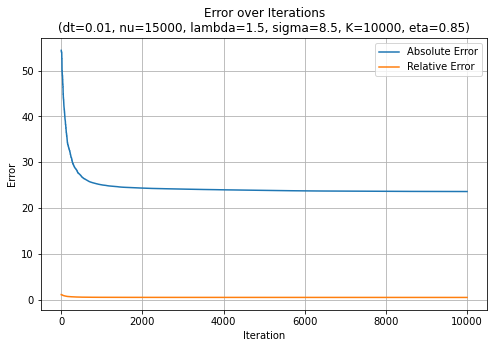

,dt,nu,lambda,sigma,eta,K,consensus_abs_error,consensus_rel_error
0,0.01,15000,1.5,8.5,0.85,10000,23.599063,0.474874


In [70]:
import itertools
import numpy as np
import pandas as pd
import tensorly as tl
from tensorly.cp_tensor import cp_to_tensor
import matplotlib.pyplot as plt
import random
random.seed(42)
np.random.seed(42)

# Define parameters
I, J, K_tensor = 15, 20, 25
rank = 10
np.random.seed(42)
tensor = tl.tensor(np.random.uniform(0, 1, (I, J, K_tensor)))

alpha_0 = 1e3
alpha_final = 1e15

# Instead of separate lambda_list and sigma_list, we create pairs:
dt_list = [0.01]
nu_list = [15000]
lambda_sigma_list = [(1.5, 8.5)]
#lambda_sigma_list = [(1, 7), (1.5, 8.5), (2, 10)]  # each tuple is (lambda_, sigma)
K_list = [10000]
eta_list = [0.85]

# Generate the parameter grid using the paired (lambda_, sigma) list
param_grid = list(itertools.product(dt_list, nu_list, lambda_sigma_list, K_list, eta_list))

def alpha_sequence(alpha_0, alpha_K, K):
    ks = np.arange(K+1)
    alphas = alpha_0 + (ks / K) * (alpha_K - alpha_0)
    return alphas

def objective_function(particle, tensor, rank):
    A = particle['A']
    B = particle['B']
    C = particle['C']
    reconstructed_tensor = cp_to_tensor((np.ones(rank), [A, B, C]))
    error = tl.norm(tensor - reconstructed_tensor)
    return error

def compute_consensus_point(particles, alpha, tensor, rank):
    min_energy_particle = min(particles, key=lambda p: objective_function(p, tensor, rank))
    min_energy = objective_function(min_energy_particle, tensor, rank)

    numerator_A = np.zeros_like(particles[0]['A'])
    numerator_B = np.zeros_like(particles[0]['B'])
    numerator_C = np.zeros_like(particles[0]['C'])
    denominator = 0.0

    for particle in particles:
        energy = objective_function(particle, tensor, rank)
        weight = np.exp(-alpha * (energy - min_energy))
        numerator_A += weight * particle['A']
        numerator_B += weight * particle['B']
        numerator_C += weight * particle['C']
        denominator += weight

    consensus_A = numerator_A / denominator
    consensus_B = numerator_B / denominator
    consensus_C = numerator_C / denominator
    return {'A': consensus_A, 'B': consensus_B, 'C': consensus_C}

def project_matrices_to_ball(particles, consensus_point, eta):
    """
    Project the matrices A, B, and C of each particle into a shrinking ball
    centered on the consensus point.

    Parameters:
    - particles: list of particles, each with matrices 'A', 'B', 'C'.
    - consensus_point: dictionary with matrices 'A', 'B', 'C' as consensus point.
    - eta: shrinking factor (0 < eta ≤ 1).

    Returns:
    - Projected particles.
    """
    for particle in particles:
        for key in ['A', 'B', 'C']:
            # Flatten matrices to vectors
            vec_particle = particle[key].flatten()
            vec_consensus = consensus_point[key].flatten()

            # --- L2-norm version (Euclidean ball) ---
            distance = np.linalg.norm(vec_particle - vec_consensus)
            radius = eta * distance

            # Perform projection if outside the ball
            if distance > radius:
                direction = (vec_particle - vec_consensus) / distance
                vec_particle = vec_consensus + radius * direction

            # Reshape back to original matrix form
            particle[key] = vec_particle.reshape(particle[key].shape)
    return particles

def anisotropic_update(particles, consensus_point, lambda_, sigma, dt, tensor, rank):
    consensus_point_loss = objective_function(consensus_point, tensor, rank)
    for particle in particles:
        A, B, C = particle['A'], particle['B'], particle['C']
        A_consensus, B_consensus, C_consensus = consensus_point['A'], consensus_point['B'], consensus_point['C']

        current_loss = objective_function(particle, tensor, rank)
        if consensus_point_loss < current_loss:
            drift_A = (-lambda_) * (A - A_consensus) * dt
            drift_B = (-lambda_) * (B - B_consensus) * dt
            drift_C = (-lambda_) * (C - C_consensus) * dt
        else:
            drift_A = np.zeros_like(A)
            drift_B = np.zeros_like(B)
            drift_C = np.zeros_like(C)

        # Normal distribution noise
        B_A = np.random.normal(loc=0, scale=1, size=A.shape)
        B_B = np.random.normal(loc=0, scale=1, size=B.shape)
        B_C = np.random.normal(loc=0, scale=1, size=C.shape)

        diffusion_A = sigma * (A - A_consensus) * B_A * np.sqrt(dt)
        diffusion_B = sigma * (B - B_consensus) * B_B * np.sqrt(dt)
        diffusion_C = sigma * (C - C_consensus) * B_C * np.sqrt(dt)

        particle['A'] += drift_A + diffusion_A
        particle['B'] += drift_B + diffusion_B
        particle['C'] += drift_C + diffusion_C

    return particles

# Dictionary to store results for each parameter combination
results = []

# Main loop over parameter grid
for dt, nu, (lambda_, sigma), K, eta in param_grid:
    print(f"Running with dt={dt}, nu={nu}, lambda={lambda_}, sigma={sigma}, K={K}, eta={eta}")

    # Initialize particles
    particles = []
    for _ in range(nu):
        A = np.random.uniform(0, 1, (I, rank))
        B = np.random.uniform(0, 1, (J, rank))
        C = np.random.uniform(0, 1, (K_tensor, rank))
        particles.append({'A': A, 'B': B, 'C': C})

    # Generate alpha sequence for this K
    alpha_values = alpha_sequence(alpha_0, alpha_final, K)

    abs_errors = []
    rel_errors = []

    # Iterative updates
    for iteration in range(K + 1):
        alpha_current = alpha_values[iteration]
        # Compute consensus point and its error
        consensus_point = compute_consensus_point(particles, alpha_current, tensor, rank)
        consensus_tensor = cp_to_tensor((np.ones(rank), [consensus_point['A'],
                                                         consensus_point['B'],
                                                         consensus_point['C']]))
        consensus_abs_error = tl.norm(tensor - consensus_tensor) # absolute error

        # Create a mask that is True where tensor != 0
        nonzero_mask = tensor != 0
        consensus_rel_error = tl.norm(tensor[nonzero_mask] - consensus_tensor[nonzero_mask]) / tl.norm(tensor[nonzero_mask])

        # Store errors
        abs_errors.append(consensus_abs_error)
        rel_errors.append(consensus_rel_error)

        # Update particles and project if not the last iteration
        if iteration < K:
            particles = anisotropic_update(
                particles, consensus_point,
                lambda_=lambda_, sigma=sigma,
                dt=dt, tensor=tensor, rank=rank
            )
            particles = project_matrices_to_ball(particles, consensus_point, eta)

        print(f"iteration: {iteration}, abs error: {consensus_abs_error}, rel error: {consensus_rel_error}")

    # -- Plot the error curves for this parameter combination --
    plt.figure(figsize=(8, 5))
    plt.plot(range(K+1), abs_errors, label='Absolute Error')
    plt.plot(range(K+1), rel_errors, label='Relative Error')
    plt.xlabel('Iteration')
    plt.ylabel('Error')
    plt.title(f"Error over Iterations\n(dt={dt}, nu={nu}, lambda={lambda_}, sigma={sigma}, K={K}, eta={eta})")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Store results
    results.append({
        'dt': dt,
        'nu': nu,
        'lambda': lambda_,
        'sigma': sigma,
        'eta': eta,
        'K': K,
        'consensus_abs_error': abs_errors[-1],
        'consensus_rel_error': rel_errors[-1]
    })

# Convert results to a DataFrame
df_results_with_heurs = pd.DataFrame(results)
df_results_with_heurs


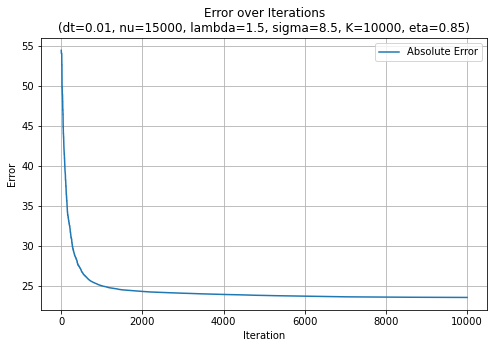

In [71]:
plt.figure(figsize=(8, 5))
plt.plot(range(K+1), abs_errors, label='Absolute Error')
plt.xlabel('Iteration')
plt.ylabel('Error')
plt.title(f"Error over Iterations\n(dt={dt}, nu={nu}, lambda={lambda_}, sigma={sigma}, K={K}, eta={eta})")
plt.legend()
plt.grid(True)
plt.show()

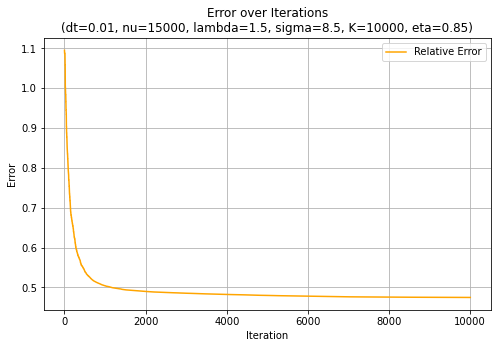

In [72]:
plt.figure(figsize=(8, 5))
plt.plot(range(K+1), rel_errors, color='orange', label='Relative Error')
plt.xlabel('Iteration')
plt.ylabel('Error')
plt.title(f"Error over Iterations\n(dt={dt}, nu={nu}, lambda={lambda_}, sigma={sigma}, K={K}, eta={eta})")
plt.legend()
plt.grid(True)
plt.show()

In [73]:
#df_results_with_heurs.to_excel("new_25x25x25torank10_with_relative_errors_values_btw_0_1_all.xlsx", index=False)

In [74]:
particles

[{'A': array([[ 0.22644272,  0.14915727, -0.0049722 ,  0.3753571 , -0.36289334,
           0.35446531,  0.70176298, -0.04289176,  0.35274542,  0.25735147],
         [ 0.67205294,  0.02391998,  0.27419475,  0.62648479, -0.06652328,
           0.26573931,  0.29560862, -0.10980079,  0.31113126,  0.34277382],
         [ 0.46247173,  0.16174008, -0.22704344,  0.28037792,  0.21963463,
           0.32213796,  0.63312359,  0.36866275,  0.38084234,  0.26117662],
         [ 0.35916346,  0.10940762, -0.23228354,  0.49587528,  0.33864596,
           0.40670466,  0.49824665,  0.07842207,  0.30778548,  0.23965831],
         [ 0.26788491,  0.45095306, -0.32818085,  0.12333108, -0.02659512,
           0.45358943,  0.57555772,  0.55667914,  0.37018505,  0.03349867],
         [ 0.45519638,  0.28930033,  0.27714138,  0.48868863, -0.00263255,
           0.21364265,  0.46910573, -0.14630238,  0.24528307,  0.72678726],
         [ 0.48393803,  0.42074372, -0.04440924,  0.64787545,  0.18285675,
           0.4

In [75]:
consensus_point

{'A': array([[ 0.22169858,  0.14912671, -0.00501132,  0.37533079, -0.36289553,
          0.35446514,  0.70173073, -0.04289188,  0.35296208,  0.25734934],
        [ 0.67205294,  0.02392746,  0.27419349,  0.62648479, -0.06653555,
          0.26573931,  0.29560862, -0.10980796,  0.31113126,  0.34259795],
        [ 0.46183599,  0.16174008, -0.22704344,  0.28035233,  0.2196733 ,
          0.32213796,  0.63312772,  0.36866275,  0.38096814,  0.26117662],
        [ 0.35916333,  0.11052651, -0.23228354,  0.49587528,  0.26670602,
          0.40670466,  0.49824377,  0.07962885,  0.30778548,  0.23965833],
        [ 0.25936464,  0.44483491, -0.3281824 ,  0.1234018 , -0.02659512,
          0.45358943,  0.57555772,  0.55667914,  0.36967268,  0.03349854],
        [ 0.45545136,  0.28916673,  0.27704523,  0.48848652, -0.00255856,
          0.21350115,  0.46876558, -0.14365908,  0.24528206,  0.72679008],
        [ 0.48397769,  0.42074372, -0.04438849,  0.64789263,  0.1828602 ,
          0.4045351 ,  0.13

In [76]:
from scipy.stats import truncnorm

def truncated_normal_noise(shape, mean=0.0, std=1.0, lower=-0.01, upper=0.01):
    """
    Generate an array of truncated normal samples with the given shape.
    The underlying distribution is Normal(mean, std^2), but restricted
    to lie in [lower, upper].
    """
    # Compute the normalized bounds
    a = (lower - mean) / std
    b = (upper - mean) / std

    # Generate the samples
    noise = truncnorm(a, b, loc=mean, scale=std).rvs(size=shape)
    return noise

def resample_particles_around_consensus_truncnorm(particles, consensus_point):
    """
    For each particle p in 'particles', draw a truncated normal random value
    for each element (mean=0, std=1, truncated to [-0.05, 0.05]) and add it
    to the consensus_point's factor matrices.

    particles: list of dicts, each dict = {'A': <ndarray>, 'B': <ndarray>, 'C': <ndarray>}
    consensus_point: dict = {'A': <ndarray>, 'B': <ndarray>, 'C': <ndarray>}

    Returns the updated 'particles' with new factor matrices.
    """
    for p in particles:
        for key in ['A', 'B', 'C']:
            shape = consensus_point[key].shape

            # Sample noise from a truncated normal distribution
            noise = truncated_normal_noise(
                shape=shape,
                mean=0.0,
                std=1.0,
                lower=-0.01,
                upper=0.01
            )

            # Update the particle: factor_matrix = factor_matrix_consensus + noise
            p[key] = consensus_point[key] + noise

    return particles


In [77]:
resample_particles_around_consensus_truncnorm(particles=particles, consensus_point=consensus_point)

[{'A': array([[ 0.22012231,  0.15011904, -0.00197231,  0.38306772, -0.35797418,
           0.35567742,  0.6935731 , -0.03463641,  0.34748526,  0.26440769],
         [ 0.67094714,  0.01962999,  0.28217119,  0.62632432, -0.0620264 ,
           0.27436944,  0.28720579, -0.11235429,  0.3078862 ,  0.33586845],
         [ 0.46274005,  0.15215501, -0.22860303,  0.2810151 ,  0.21912492,
           0.31562254,  0.63491155,  0.37326458,  0.38154102,  0.26813025],
         [ 0.3494424 ,  0.10380597, -0.24033872,  0.50040035,  0.27356727,
           0.40281785,  0.49916376,  0.08451466,  0.30195173,  0.24678154],
         [ 0.25569098,  0.45274161, -0.32387352,  0.11652063, -0.02063898,
           0.45873963,  0.58043592,  0.55591963,  0.37140858,  0.03337161],
         [ 0.45708459,  0.28739654,  0.27416684,  0.47994392, -0.00441879,
           0.21595995,  0.46278409, -0.13622553,  0.24832607,  0.72516924],
         [ 0.49230475,  0.42468719, -0.03746607,  0.64145848,  0.18445546,
           0.4

In [78]:

# Dictionary to store results for each parameter combination
results_2 = []

# Main loop over parameter grid
for dt, nu, (lambda_, sigma), K, eta in param_grid:
    print(f"Running with dt={dt}, nu={nu}, lambda={lambda_}, sigma={sigma}, K={K}, eta={eta}")

    # Generate alpha sequence for this K
    alpha_values = alpha_sequence(alpha_0, alpha_final, K)

    abs_errors_2 = []
    rel_errors_2 = []

    # Iterative updates
    for iteration in range(K + 1):
        alpha_current = alpha_values[iteration]
        # Compute consensus point and its error
        consensus_point = compute_consensus_point(particles, alpha_current, tensor, rank)
        consensus_tensor = cp_to_tensor((np.ones(rank), [consensus_point['A'],
                                                         consensus_point['B'],
                                                         consensus_point['C']]))
        consensus_abs_error = tl.norm(tensor - consensus_tensor) # absolute error

        # Create a mask that is True where tensor != 0
        nonzero_mask = tensor != 0
        consensus_rel_error = tl.norm(tensor[nonzero_mask] - consensus_tensor[nonzero_mask]) / tl.norm(tensor[nonzero_mask])

        # Store errors
        abs_errors_2.append(consensus_abs_error)
        rel_errors_2.append(consensus_rel_error)

        # Print iteration info
        print(f"iteration: {iteration}, abs error: {consensus_abs_error}, rel error: {consensus_rel_error}")

        # Update particles and project if not the last iteration
        if iteration < K:
            particles = anisotropic_update(
                particles, consensus_point,
                lambda_=lambda_, sigma=sigma,
                dt=dt, tensor=tensor, rank=rank
            )
            particles = project_matrices_to_ball(particles, consensus_point, eta)

        print(f"iteration: {iteration}, abs error: {consensus_abs_error}, rel error: {consensus_rel_error}")

    # -- Plot the error curves for this parameter combination --
    plt.figure(figsize=(8, 5))
    plt.plot(range(K+1), abs_errors_2, label='Absolute Error')
    plt.plot(range(K+1), rel_errors_2, label='Relative Error')
    plt.xlabel('Iteration')
    plt.ylabel('Error')
    plt.title(f"Error over Iterations\n(dt={dt}, nu={nu}, lambda={lambda_}, sigma={sigma}, K={K}, eta={eta})")
    plt.legend()
    plt.grid(True)
    plt.show()

    # Store results
    results.append({
        'dt': dt,
        'nu': nu,
        'lambda': lambda_,
        'sigma': sigma,
        'eta': eta,
        'K': K,
        'consensus_abs_error': abs_errors_2[-1],
        'consensus_rel_error': rel_errors_2[-1]
    })

# Convert results to a DataFrame
df_results_with_heurs_2 = pd.DataFrame(results_2)
df_results_with_heurs_2

Running with dt=0.01, nu=15000, lambda=1.5, sigma=8.5, K=10000, eta=0.85
iteration: 0, abs error: 23.597631544090568, rel error: 0.4748450123660759
iteration: 0, abs error: 23.597631544090568, rel error: 0.4748450123660759
iteration: 1, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 1, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 2, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 2, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 3, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 3, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 4, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 4, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 5, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 5, abs error: 23.600888498508326, rel error: 0.4749105506620649
iteration: 6, abs error: 23

KeyboardInterrupt: 

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(range(K+1), abs_errors_2, label='Absolute Error')
plt.xlabel('Iteration')
plt.ylabel('Error')
plt.title(f"Error over Iterations\n(dt={dt}, nu={nu}, lambda={lambda_}, sigma={sigma}, K={K}, eta={eta})")
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
plt.figure(figsize=(8, 5))
plt.plot(range(K+1), rel_errors_2, label='Absolute Error')
plt.xlabel('Iteration')
plt.ylabel('Error')
plt.title(f"Error over Iterations\n(dt={dt}, nu={nu}, lambda={lambda_}, sigma={sigma}, K={K}, eta={eta})")
plt.legend()
plt.grid(True)
plt.show()